In [1]:
!pip install folium

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score
from sklearn.preprocessing import MaxAbsScaler
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
import warnings
import folium

In [3]:
#Mount the drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
#Get the data
airbnb = pd.read_csv("/content/drive/Shareddrives/Ensemble Learning/Airbnb project/data_NYC_2019.csv")

#EDA

In [5]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [6]:
airbnb.shape

(48895, 16)

In [7]:
airbnb.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [8]:
#Explore null values
airbnb.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

So we have 10052 listing with no last_review or reviews_per_month. Those can probably be new listings in the platform (we can create a binary column for this)

#### Feel NA's appropriately

In [9]:
# Fill string columns' na with unknown
airbnb['name'].fillna('unknown',inplace=True)
airbnb['host_name'].fillna('unknown',inplace=True)

# Fill numerical columns' na with the mean
airbnb['reviews_per_month'].fillna(0,inplace=True)
'''not filling last_review yet to use it for feature engineering'''

airbnb.isnull().sum()

id                                    0
name                                  0
host_id                               0
host_name                             0
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                     0
calculated_host_listings_count        0
availability_365                      0
dtype: int64

id


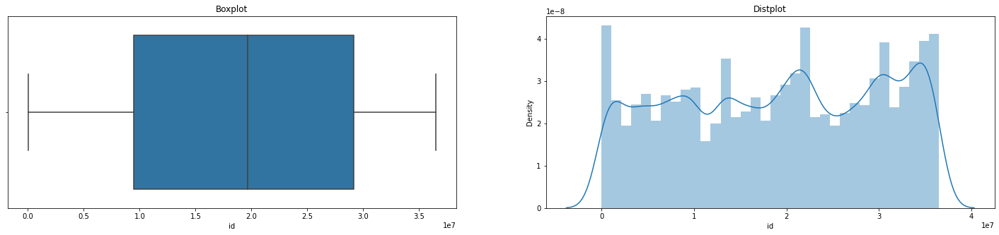

host_id


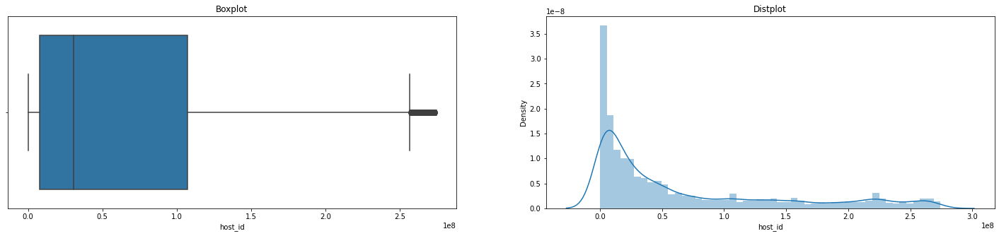

latitude


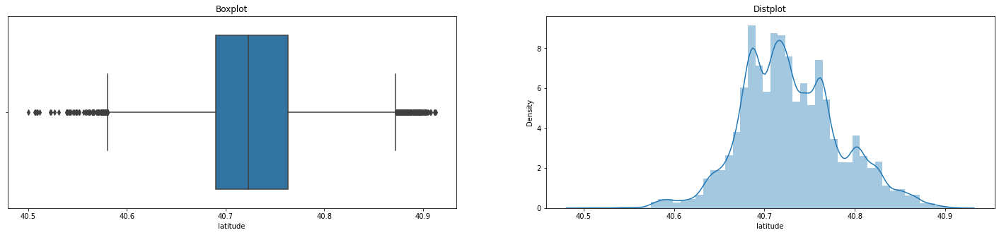

longitude


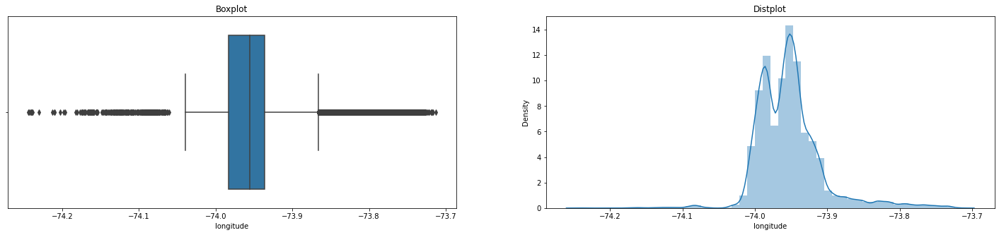

price


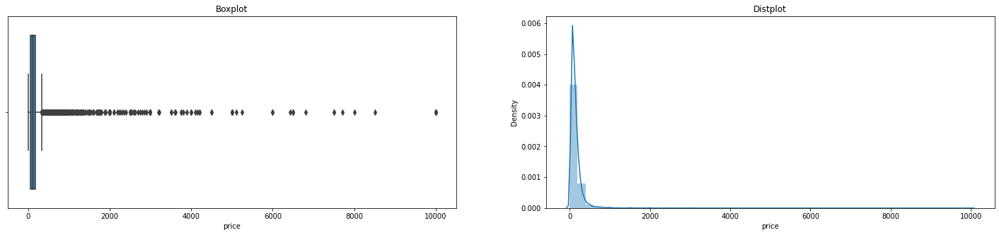

minimum_nights


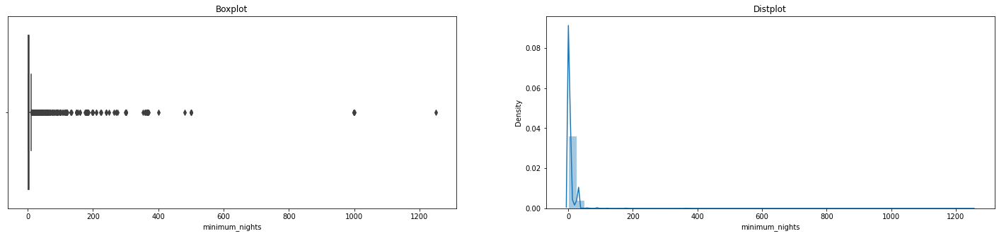

number_of_reviews


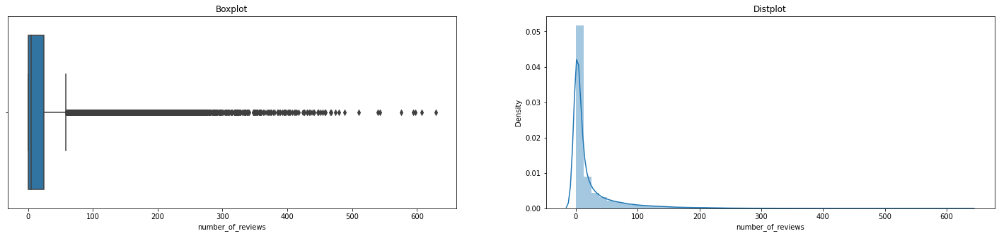

reviews_per_month


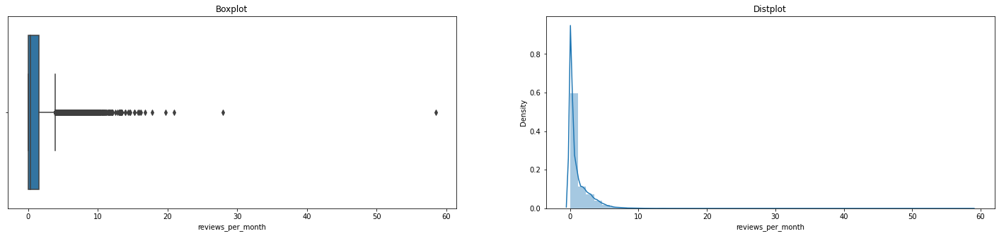

calculated_host_listings_count


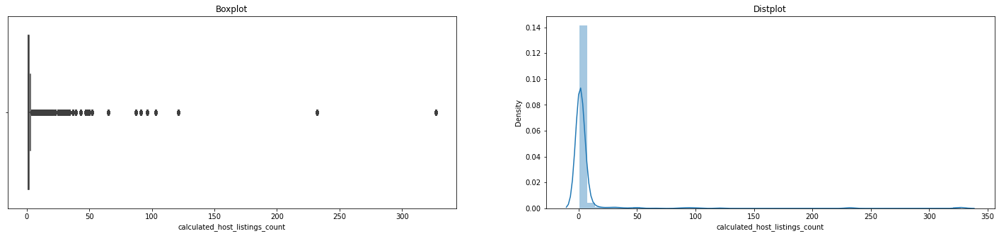

availability_365


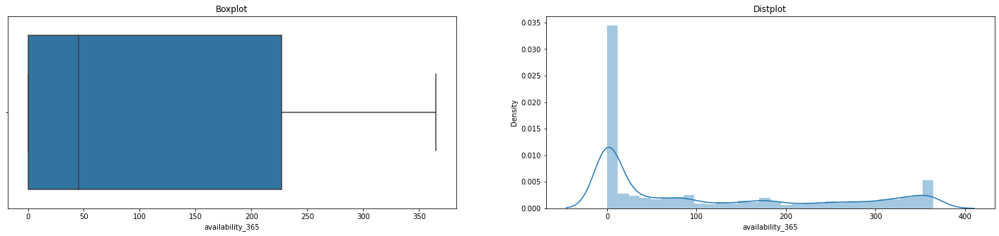

In [10]:
#Distribution of columns
numerical_cols = airbnb.select_dtypes(include=['int', 'float']).columns.tolist()

# Create boxplots for each numerical column
for col in numerical_cols:
  fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(25, 5))

  print(col)
  #Boxplot
  axes[0].set_title('Boxplot')
  sns.boxplot(data=airbnb, x=col, ax=axes[0])

  #Distplot
  axes[1].set_title('Distplot')
  with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sns.distplot(airbnb[col], ax=axes[1])

  plt.show()

We clearly have a lot of outliers

<AxesSubplot:xlabel='price', ylabel='Count'>

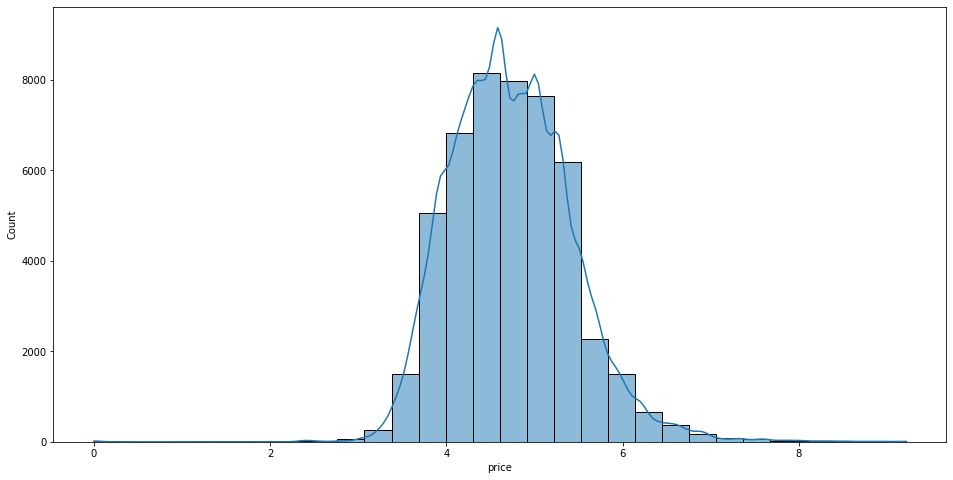

In [11]:
#Plotting the log of the price
plt.figure(figsize=(16,8))
sns.histplot(data=airbnb,x=np.log(airbnb['price'] + 1), bins=30, kde=True)

So we have 3 different room types with shared room being quite underrepresented in the data.

/usr/local/lib/python3.9/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


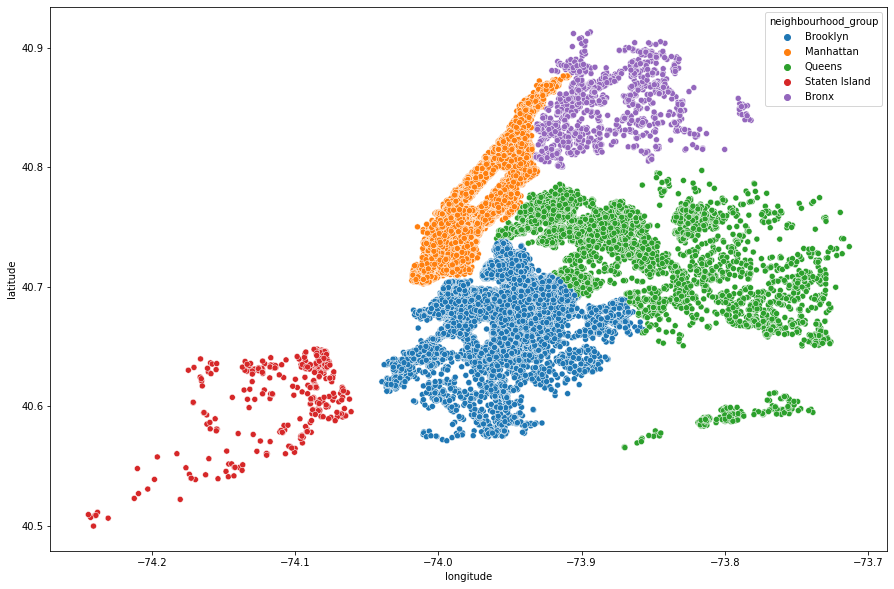

In [12]:
# map of neighbourhood group
plt.figure(figsize=(15,10))
sns.scatterplot(airbnb.longitude,airbnb.latitude,hue=airbnb.neighbourhood_group)
plt.ioff()

Insights:

Not too many new listings on the Staten Island

Most new listing on Manhattan and Centre of Brooklyn (maybe worth differenciating between centre and non-centre)

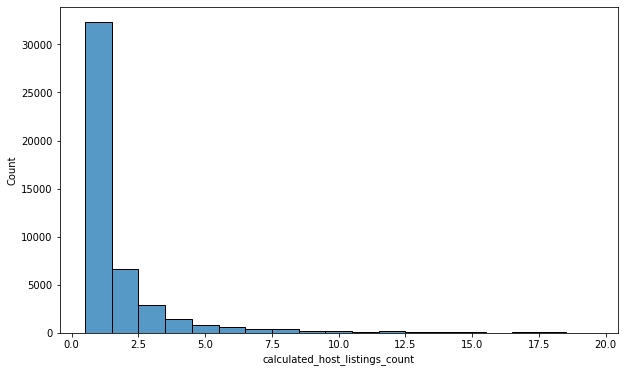

In [13]:
#Distribution of calculated_host_listings_count
#Distplot
fig = plt.figure(figsize=(10, 6))
sns.histplot(airbnb["calculated_host_listings_count"][airbnb.calculated_host_listings_count<20], discrete=True)
plt.show()

In [14]:
airbnb.calculated_host_listings_count.value_counts()

1      32303
2       6658
3       2853
4       1440
5        845
6        570
8        416
7        399
327      327
9        234
232      232
10       210
96       192
12       180
13       130
121      121
11       110
52       104
103      103
33        99
49        98
91        91
87        87
15        75
14        70
23        69
34        68
17        68
65        65
31        62
28        56
18        54
25        50
50        50
47        47
43        43
20        40
39        39
37        37
32        32
30        30
29        29
27        27
26        26
21        21
19        19
16        16
Name: calculated_host_listings_count, dtype: int64

Wherever they match it means that there is only one person having that many listings

/usr/local/lib/python3.9/dist-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


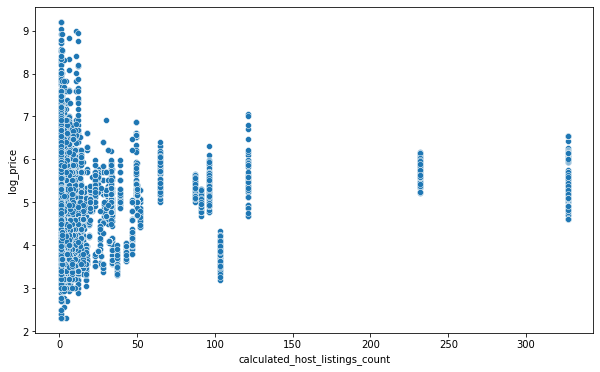

In [15]:
fig = plt.figure(figsize=(10, 6))
temp = airbnb.copy()
temp['log_price'] = np.log(temp['price'])
sns.scatterplot(data=temp, x='calculated_host_listings_count', y='log_price')
plt.show()

The price varies more for hosts having less listings. Maybe not helpful since there are more hosts with less listings in general

<AxesSubplot:>

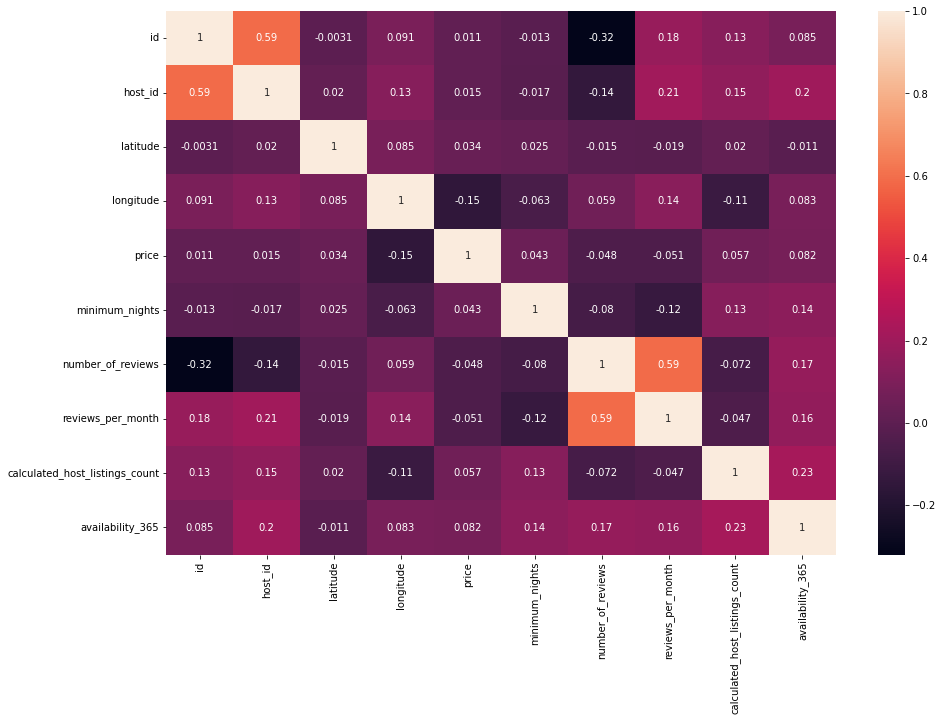

In [16]:
# Correlation man
corr = airbnb.corr()
plt.figure(figsize=(15,10))
sns.heatmap(corr, annot=True)

In [17]:
print('In this dataset there are {} unique hosts renting out a total number of {} properties.'.format(len(airbnb['host_id'].unique()), airbnb.shape[0]))

In this dataset there are 37457 unique hosts renting out a total number of 48895 properties.


#### Room type

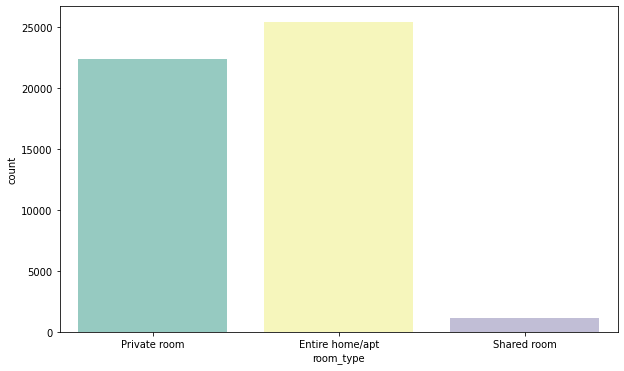

In [18]:
# Distribution of room_type
fig = plt.figure(figsize=(10, 6))
sns.countplot(data=airbnb, x="room_type", palette='Set3')
plt.show()

/usr/local/lib/python3.9/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


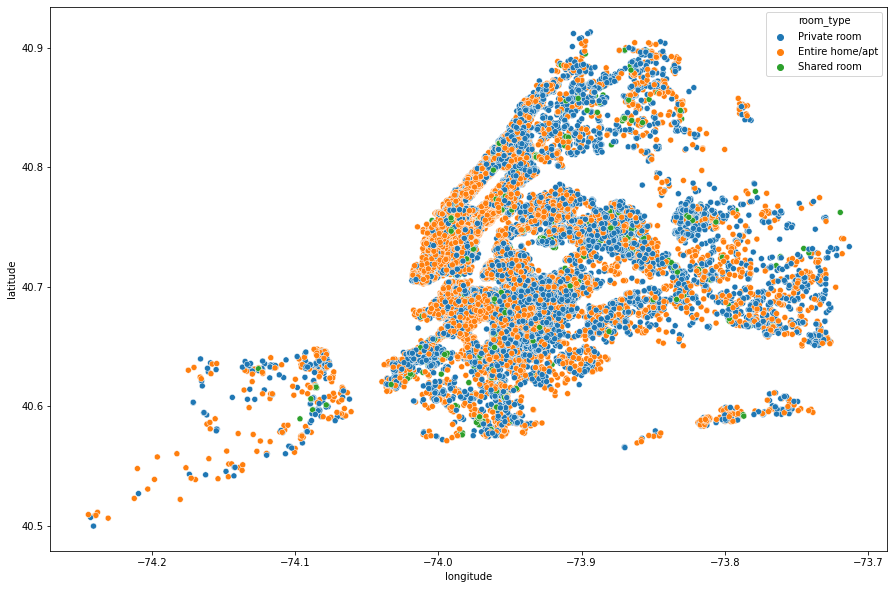

In [19]:
# map of the room type
plt.figure(figsize=(15,10))
sns.scatterplot(airbnb.longitude,airbnb.latitude,hue=airbnb.room_type)
plt.ioff()

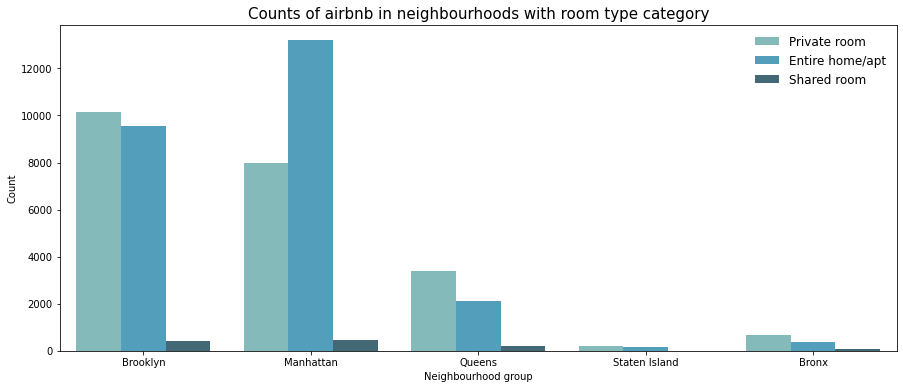

In [20]:
# Neighbourhood groups with counts with category room_type

plt.figure(figsize=(15,6))
sns.countplot(data=airbnb, x='neighbourhood_group', hue='room_type', palette='GnBu_d')
plt.title('Counts of airbnb in neighbourhoods with room type category', fontsize=15)
plt.xlabel('Neighbourhood group')
plt.ylabel("Count")
plt.legend(frameon=False, fontsize=12)

#### Neighbourhood group

/usr/local/lib/python3.9/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'Neighbourhood Group')

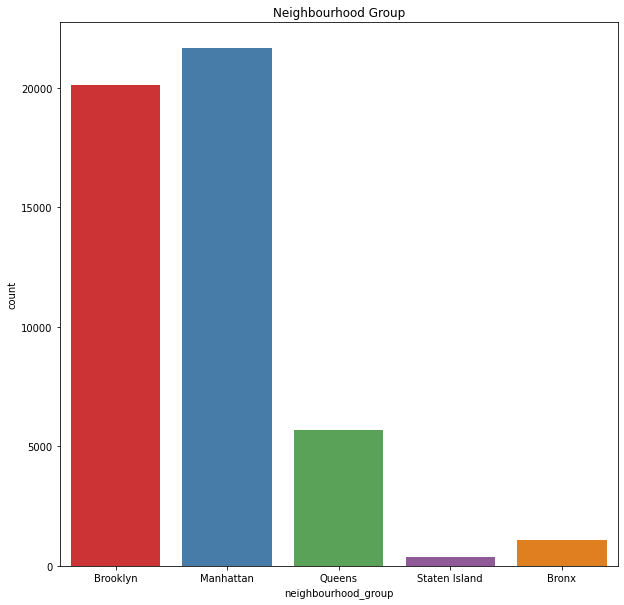

In [21]:
# The entries in the "neighbourhood_group"
sns.countplot(airbnb['neighbourhood_group'], palette = 'Set1')
fig = plt.gcf()
fig.set_size_inches(10,10)
plt.title('Neighbourhood Group')

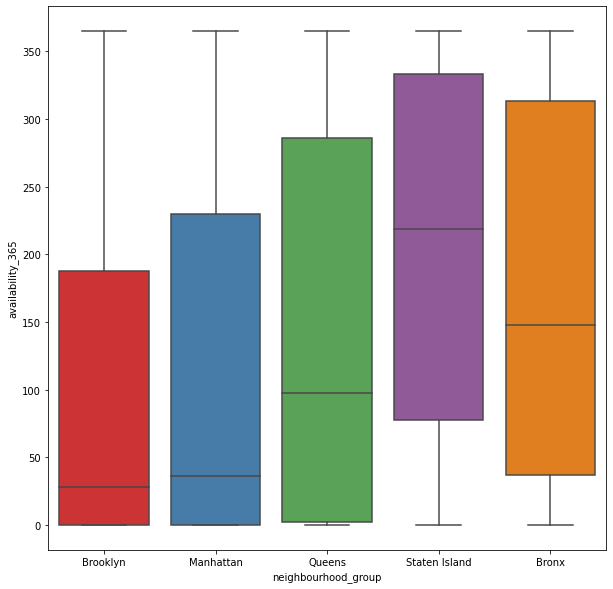

In [22]:
# Relation between neighbourgroup and Availability of Room
plt.figure(figsize=(10,10))
ax = sns.boxplot(data=airbnb, x='neighbourhood_group',y='availability_365',palette='Set1')

Significantly higher availability in Staten Island, significantly low in Brooklyn and Manhattan

Text(0, 0.5, 'Price')

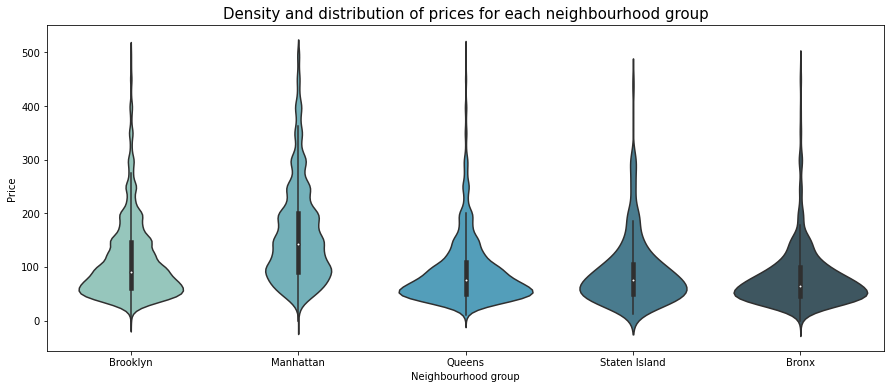

In [23]:
# Distribution of prices for each neighboorhood group
plt.figure(figsize=(15,6))
sns.violinplot(data=airbnb[airbnb.price <500], x='neighbourhood_group', y='price', palette='GnBu_d') #<500 to get rid of outliers
plt.title('Density and distribution of prices for each neighbourhood group', fontsize=15)
plt.xlabel('Neighbourhood group')
plt.ylabel("Price")

#### Outliers

In [24]:
Q1 = airbnb['price'].quantile(0.25)
Q3 = airbnb['price'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

airbnb['outlier'] = np.where((airbnb['price'] < lower_bound) | (airbnb['price'] > upper_bound), 1, 0)

In [25]:
# Create a folium map centered at the average latitude and longitude of your data
mean_lat = airbnb['latitude'].mean()
mean_lon = airbnb['longitude'].mean()
map_osm = folium.Map(location=[mean_lat, mean_lon], zoom_start=11)

# Plot the data on the map and color new listings differently
for lat, lon, out in zip(airbnb['latitude'].values, airbnb['longitude'].values, airbnb['outlier'].values):
    if out == 1: #So outliers are the ones colored in light purple
        color = 'purple'
        opacity= 1
    else:
        color = 'lightpink'
        opacity = 0.2
    folium.CircleMarker(
        location=[lat, lon],
        radius=5,
        color=color,
        opacity= opacity,
        fill=True,
        fill_color=color,
        fill_opacity=opacity
    ).add_to(map_osm)

# Show the map
map_osm

We can see that most price outliers are in Manhattan